<a href="https://colab.research.google.com/github/ranawg/geo_env/blob/main/Final_Generating_cloud_masks.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install sentinelhub --upgrade

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 245.6/245.6 kB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.6/137.6 kB 9.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.4/49.4 kB 5.6 MB/s eta 0:00:00
  Created wheel for utm: filename=utm-0.7.0-py3-none-any.whl size=6084 sha256=8fd97c3ee7210b6ec11bb6f3f4d077aa90f1eb7d5a6e2566f7ee39d8a3010352
  Stored in directory: /root/.cache/pip/wheels/2f/a1/c8/543df0e8f5e824c3e92a432e32deb9cd89ae686095ee8cfcbe
Successfully built utm


In [ ]:
pip install s2cloudless

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 14.4 MB/s eta 0:00:00


In [ ]:
%pip install rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.5/21.5 MB 37.3 MB/s eta 0:00:00


In [ ]:
%matplotlib inline

import pandas as pd
from datetime import datetime
#from IPython.display import Image
#from IPython.display import HTML
import matplotlib.pyplot as plt
import numpy as np


from sklearn.preprocessing import MinMaxScaler
from datetime import datetime as dt

#import arcgis
#from arcgis.gis import GIS
#from arcgis.learn import MLModel, prepare_tabulardata
#from arcgis.raster import Raster

#from fastai.vision import *

In [ ]:
from s2cloudless import S2PixelCloudDetector, utils, download_bands_and_valid_data_mask

In [ ]:
from sentinelhub import CRS, BBox, DataCollection, MimeType, SentinelHubRequest, SHConfig, generate_evalscript
from sentinelhub.api.catalog import get_available_timestamps

In [ ]:
import numpy as np
import rasterio
from sklearn.cluster import KMeans
from sklearn.preprocessing import MinMaxScaler
from datetime import datetime as dt

## DOWNLOAD SATTLALITE DATA


In [ ]:
# In case you put the credentials into the configuration file you can leave this unchanged
CLIENT_ID = "805f9b68-902a-44b3-831e-d50b78cecdb7"
CLIENT_SECRET = "dalyKU2ZHmAo3Ap8kxrF1wwNTbodEQ5c"

config = SHConfig()

if CLIENT_ID and CLIENT_SECRET:
    config.sh_client_id = CLIENT_ID
    config.sh_client_secret = CLIENT_SECRET

In [ ]:
data_collection = DataCollection.SENTINEL2_L1C
evalscript = generate_evalscript(
    data_collection=data_collection,
    meta_bands=["dataMask"],
    merged_bands_output="bands",
    prioritize_dn=False,
)
print(evalscript)


//VERSION=3

function setup() {
    return {
        input: [{
            bands: ["B01", "B02", "B03", "B04", "B05", "B06", "B07", "B08", "B8A", "B09", "B10", "B11", "B12", "dataMask"],
            units: ["REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "REFLECTANCE", "DN"]
        }],
        output: [{id: "bands", bands: 13, sampleType: "FLOAT32"}, {id: "dataMask", bands: 1, sampleType: "UINT8"}]
    }
}

function updateOutputMetadata(scenes, inputMetadata, outputMetadata) {
    outputMetadata.userData = {
        "norm_factor":  inputMetadata.normalizationFactor
    }
}

function evaluatePixel(sample) {
    return { bands: [sample.B01, sample.B02, sample.B03, sample.B04, sample.B05, sample.B06, sample.B07, sample.B08, sample.B8A, sample.B09, sample.B10, sample.B11, sample.B12], dataMask: [sample.dataMask] };
}



In [ ]:
# Create the bounding box for NEOM
new_bbox = BBox(bbox=(35.148182, 27.979698, 35.222340, 28.039410), crs=CRS.WGS84)

In [ ]:
# Define the time range for the data
import datetime as dt
# Defining time range
timestamps = get_available_timestamps(data_collection=data_collection, config = config, bbox=new_bbox, time_interval=(dt.datetime(2022, 1 , 1), dt.datetime(2023, 12, 30)))
len(timestamps)

570

### only need to run once

In [ ]:
#define the images and the maks
bands, masks = download_bands_and_valid_data_mask(bbox=new_bbox,  timestamps=timestamps, config = config)

In [ ]:
bands.shape, masks.shape

In [ ]:
#only include data that has the full image
all_true_values = np.all(masks, axis=(1, 2))
valid_mask_indices = np.where(all_true_values)[0]
valid_masks = masks[valid_mask_indices]
valid_bands = bands[valid_mask_indices]
new_timestamps = timestamps[valid_mask_indices]

In [ ]:
valid_bands.shape, valid_masks.shape

In [ ]:
import pickle
#save the bands and masks
# Save masks into a file
np.save('/content/drive/MyDrive/Cloud Detection project/Project/masks.npy', valid_masks)

# Save images into a file
np.save('/content/drive/MyDrive/Cloud Detection project/Project.images.npy', valid_bands)

np.savez('/content/drive/MyDrive/Cloud Detection project/Project/bands_and_masks_neom_2023.npz', bands=valid_bands, masks=valid_masks)
# save the new time stamps
np.save('/content/drive/MyDrive/Cloud Detection project/Project/timestamp.npy', new_timestamps)


## Load the data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
data = np.load('/content/drive/MyDrive/Cloud Detection project/Project/bands_and_masks_neom_2023.npz')
time_stamp = np.load('/content/drive/MyDrive/Cloud Detection project/Project/timestamp.npy', allow_pickle=True)
# timestamps = np.load()
# Extract the arrays
bands = data['bands']
masks = data['masks']

# Optionally, if you want to see the shape of the arrays
print("Bands shape:", bands.shape)
print("Masks shape:", masks.shape)

Bands shape: (285, 256, 256, 13)
Masks shape: (285, 256, 256)


In [ ]:
time_stamp[0]

datetime.datetime(2022, 1, 5, 8, 32, 13)

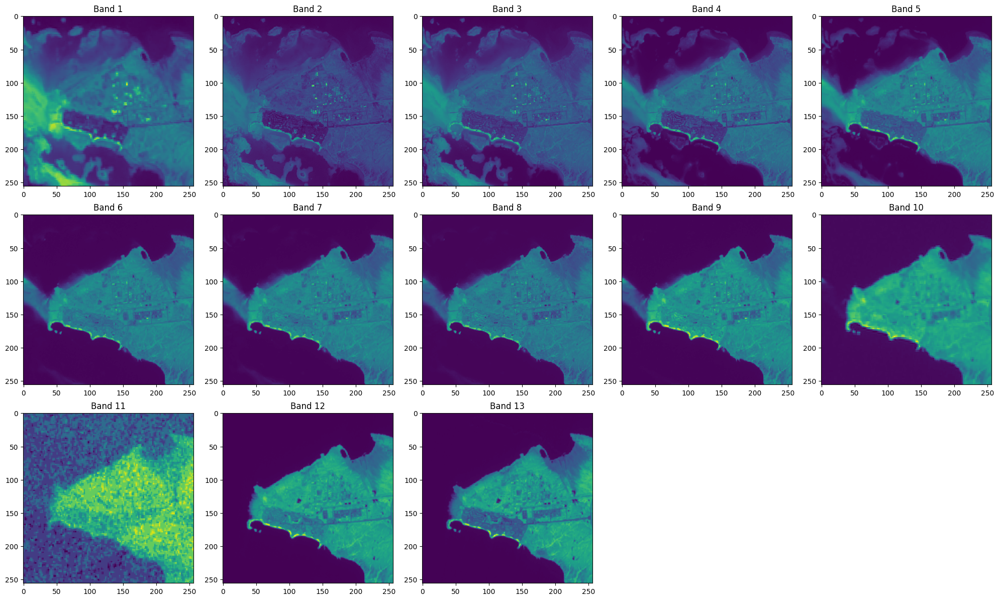

In [ ]:
#plotting one image
import matplotlib.pyplot as plt

# Select the first image from the bands array
first_image_bands = bands[0]

# Create a figure with subplots for each band
fig, axs = plt.subplots(3, 5, figsize=(20, 12))

# Plot each band (up to the first 13 bands)
for i in range(13):
    ax = axs[i // 5, i % 5]  # Calculate the subplot index
    ax.imshow(first_image_bands[..., i], cmap='viridis')  # Plot the band
    ax.set_title(f'Band {i+1}')  # Set the title for the subplot

# Remove axes for the last two empty subplots
for i in range(13, 15):
    axs[i // 5, i % 5].axis('off')

plt.tight_layout()
plt.show()





In [ ]:
import rasterio
from rasterio.transform import from_origin
from rasterio.plot import reshape_as_raster, reshape_as_image
from rasterio.crs import CRS

# Load the image data
image_data = bands[0][:, :, 0]

# Define the output TIFF file path
output_tiff_path = '/content/drive/MyDrive/Cloud Detection project/Project/band_1.tiff'

# Define the transformation for the output TIFF file
transform = from_origin(0, 0, 10, 10)  # Adjust the pixel size (10, 10) as needed

# Define the CRS
crs = CRS.from_epsg(4326)  # Example: EPSG 4326 (WGS 84)

# Save the first band of the image as a TIFF file with CRS
with rasterio.open(output_tiff_path, 'w', driver='GTiff', height=image_data.shape[0], width=image_data.shape[1], count=1, dtype=image_data.dtype, transform=transform, crs=crs) as dst:
    dst.write(image_data, 1)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

(285, 256, 256, 13)


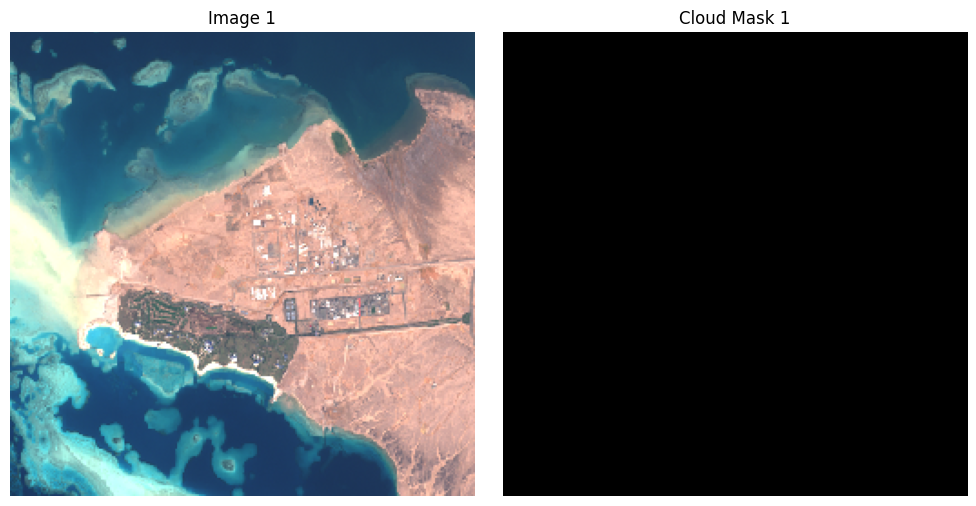

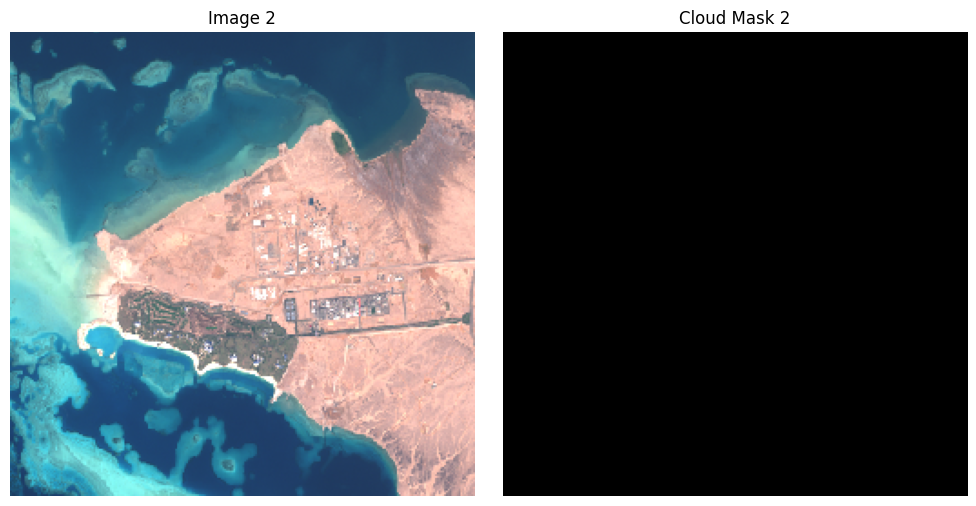

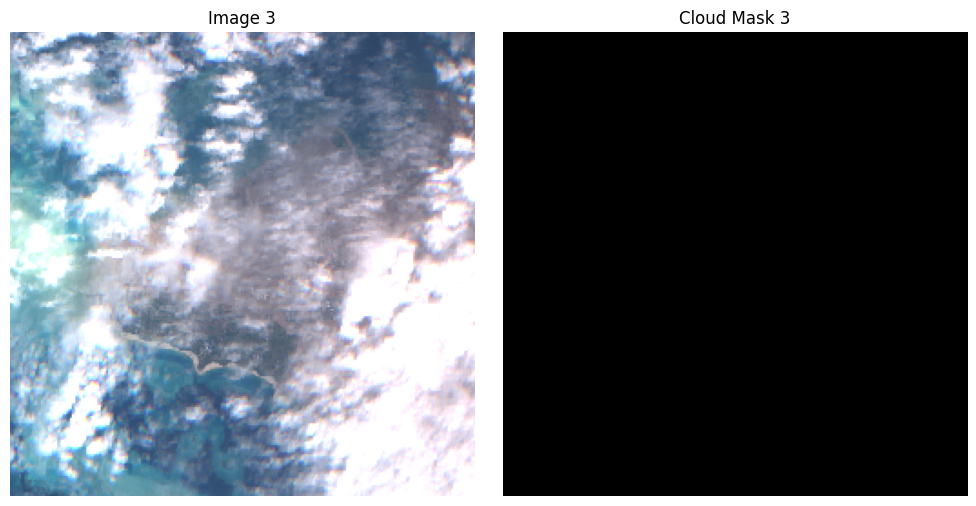

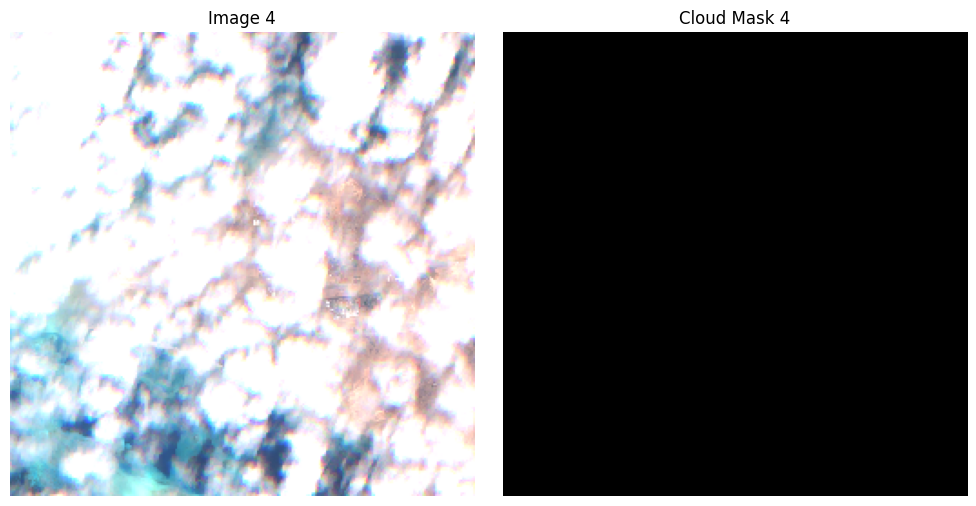

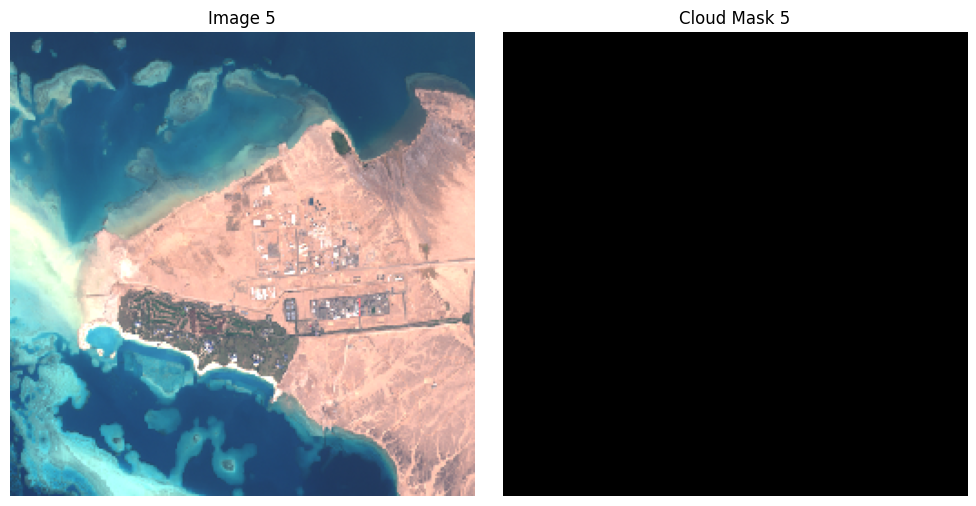

...

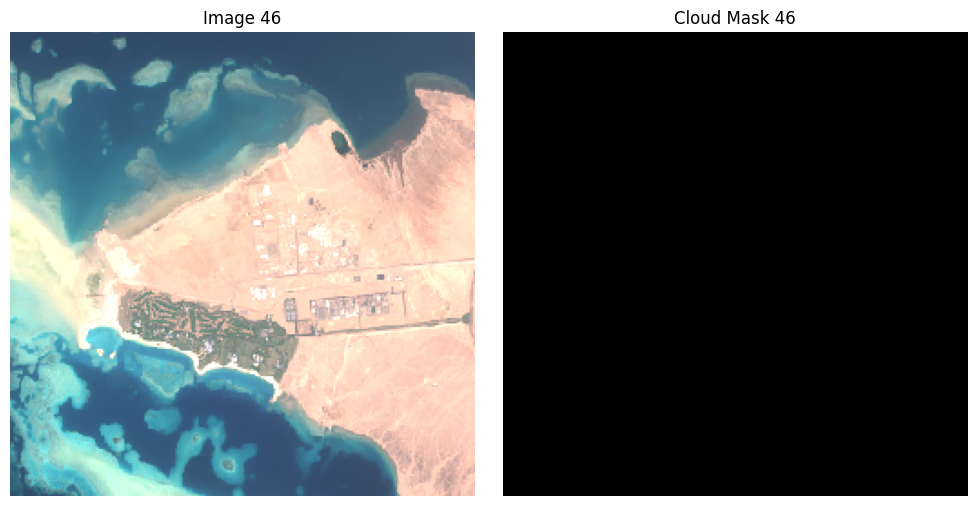

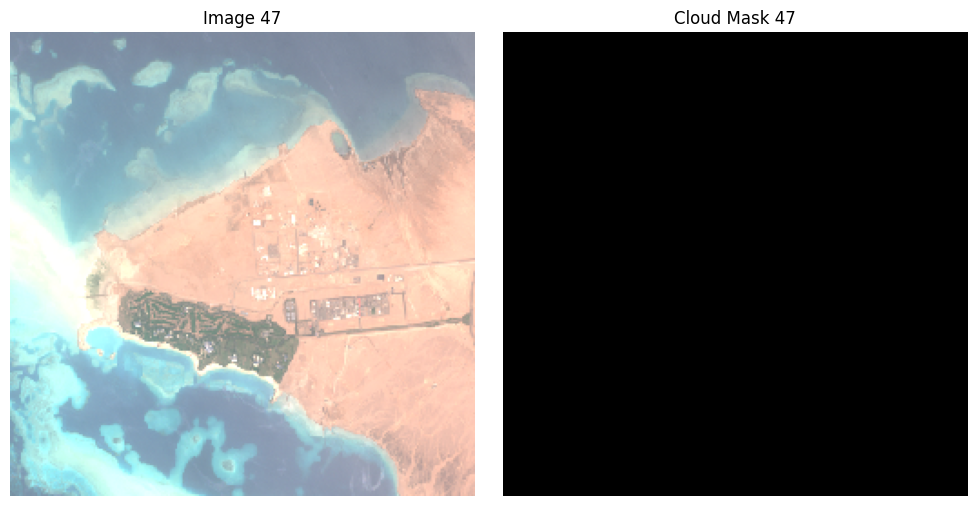

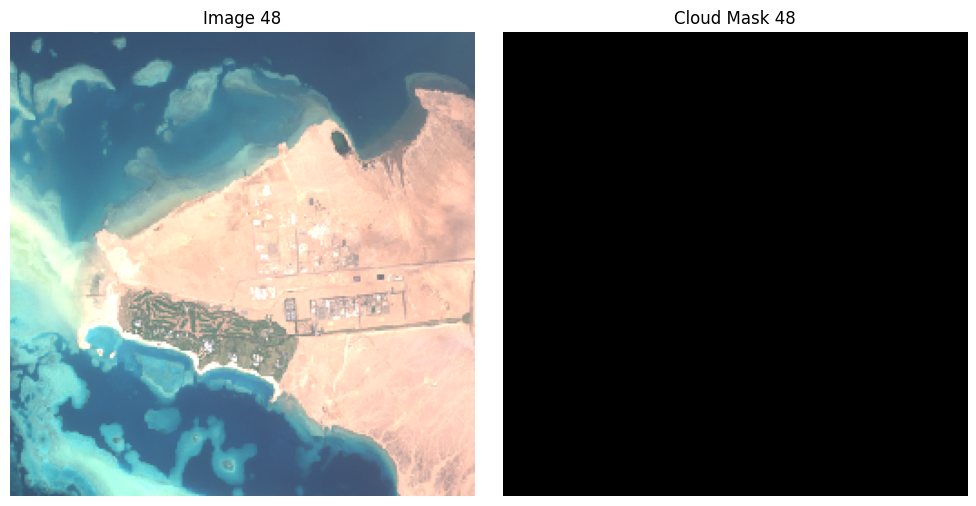

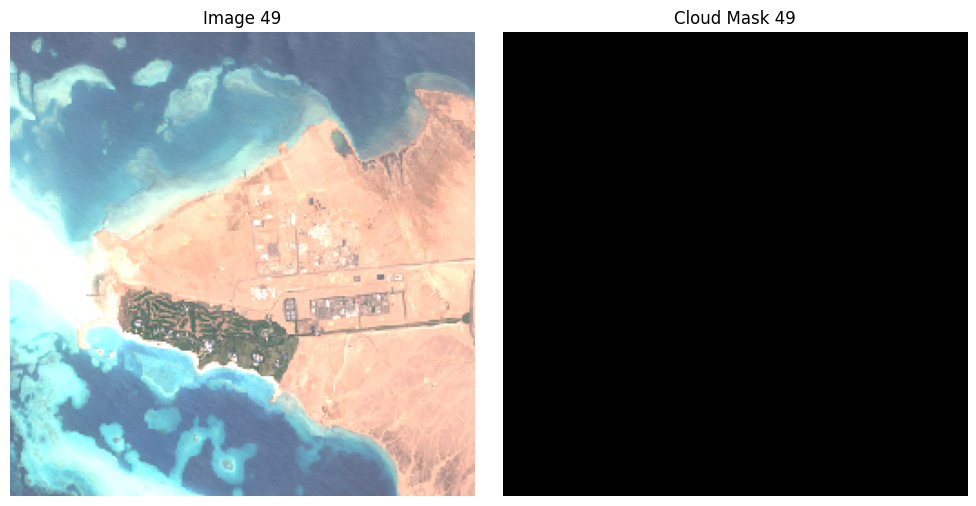

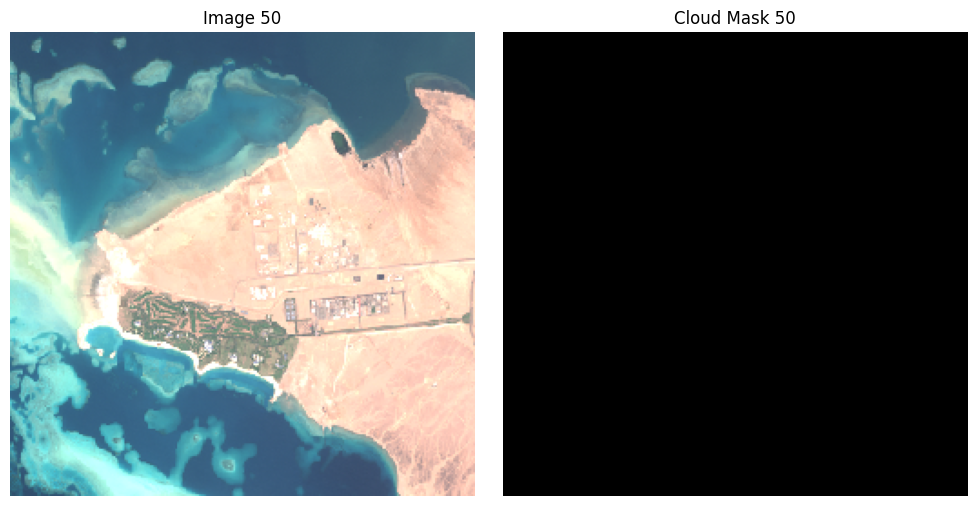

In [ ]:
import matplotlib.pyplot as plt

# Assuming you have cloud masks stored in the variable cloud_masks and true color images stored in true_color_images
cloud_masks = masks
images = (bands[..., [3, 2, 1]] * 3.5).clip(0, 1)
print(bands.shape)
for i in range(50):
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))

    # Display true color image
    axs[0].imshow(images[i])
    axs[0].set_title(f'Image {i+1}')
    axs[0].axis('off')

    # Display cloud mask
    axs[1].imshow(cloud_masks[i], cmap='gray')
    axs[1].set_title(f'Cloud Mask {i+1}')
    axs[1].axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
#we calculate the masks
cloud_detector = S2PixelCloudDetector(threshold=0.4, average_over=1, dilation_size=1, all_bands=True)

probability_maps = cloud_detector.get_cloud_probability_maps(bands)
cloud_mask = cloud_detector.get_mask_from_prob(probability_maps)

In [ ]:
#extracting rgb colors
true_color_images = np.clip(bands[..., [3, 2, 1]] * 2, 0, 1)

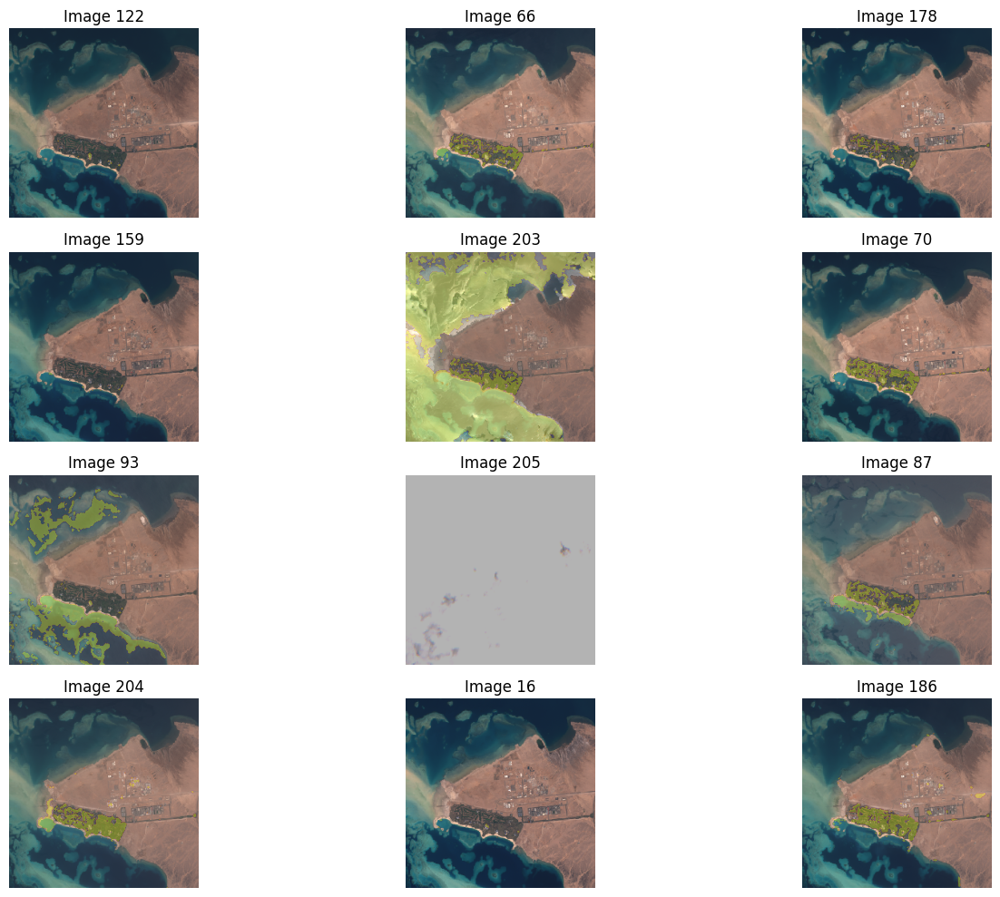

In [ ]:
random_indices = np.random.randint(0, len(true_color_images), size=12)

# Create a figure
fig = plt.figure(figsize=(15, 10))

# Define number of columns and rows
n_cols = 3
n_rows = int(np.ceil(len(random_indices) / n_cols))

# Plot each image with its mask
for idx, i in enumerate(random_indices):
    ax = fig.add_subplot(n_rows, n_cols, idx + 1)
    ax.imshow(true_color_images[i])
    ax.imshow(cloud_mask[i], cmap="gnuplot", alpha=0.3 * (cloud_mask[i] > 0))
    ax.set_title(f'Image {i+1}')
    ax.axis('off')

plt.tight_layout()
plt.show()

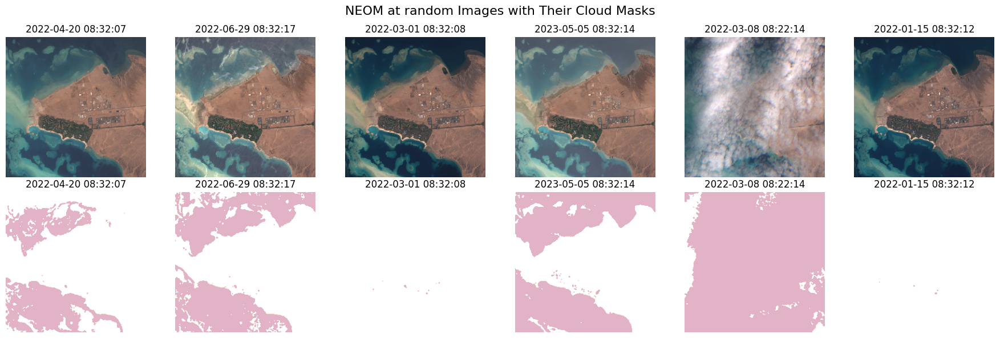

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Choose 6 random indices gnuplot
random_indices = np.random.randint(0, len(true_color_images), size=6)

# Create a figure
fig, axes = plt.subplots(2, 6, figsize=(18, 6))

# Plot each image with its mask
for idx, i in enumerate(random_indices):
    axes[0, idx].imshow(true_color_images[i])
    axes[0, idx].set_title(time_stamp[i].strftime("%Y-%m-%d %H:%M:%S"))
    axes[0, idx].axis('off')

    axes[1, idx].imshow(cloud_mask[i], cmap="Spectral_r", alpha=0.3 * (cloud_mask[i] > 0))
    axes[1, idx].set_title(time_stamp[i].strftime("%Y-%m-%d %H:%M:%S"))
    axes[1, idx].axis('off')
plt.suptitle('NEOM at random Images with Their Cloud Masks', fontsize=16)
plt.tight_layout()
plt.savefig('images_with_masks.png')
plt.show()

## Analysis

In [ ]:
#calculeing the pecentage of clouds per day
cloud_cover_per_day = np.mean(cloud_mask, axis=(1, 2)) * 100

In [ ]:
new_time = timestamps[::2]
len(new_time)

285

In [ ]:
df = pd.DataFrame({'Date': new_time, 'Cloud Cover (%)': cloud_cover_per_day})

In [ ]:
# number of days where cloud cover is more than 10%
num_cloudy_days = np.sum(cloud_cover_per_day > 10)

#percent
print("percent of cloudness more than 10% over peorid examined: %", num_cloudy_days/len(new_time)*100, )

percent of cloudness more than 10% over peorid examined: % 29.82456140350877


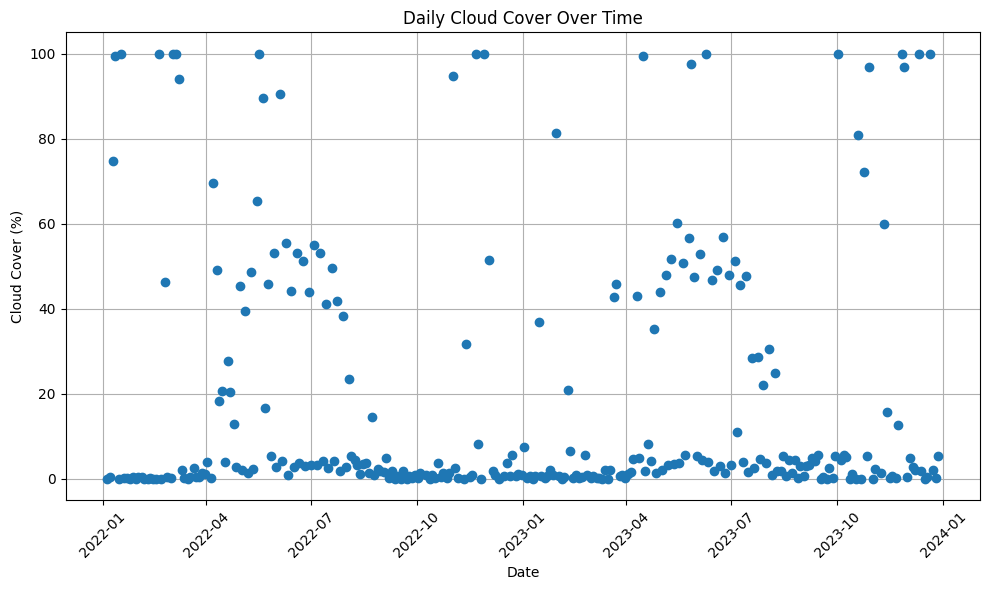

In [ ]:
#plot the cloud cover over defiifernt frequencies:

# Group by date and calculate the mean cloud cover
df_mean = df.groupby(pd.Grouper(key='Date', freq='D')).mean()

# Plot the percentage of cloud cover over time
plt.figure(figsize=(10, 6))
plt.plot(df_mean.index, df_mean['Cloud Cover (%)'], marker='o', linestyle='-')
plt.title('Daily Cloud Cover Over Time')
plt.xlabel('Date')
plt.ylabel('Cloud Cover (%)')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

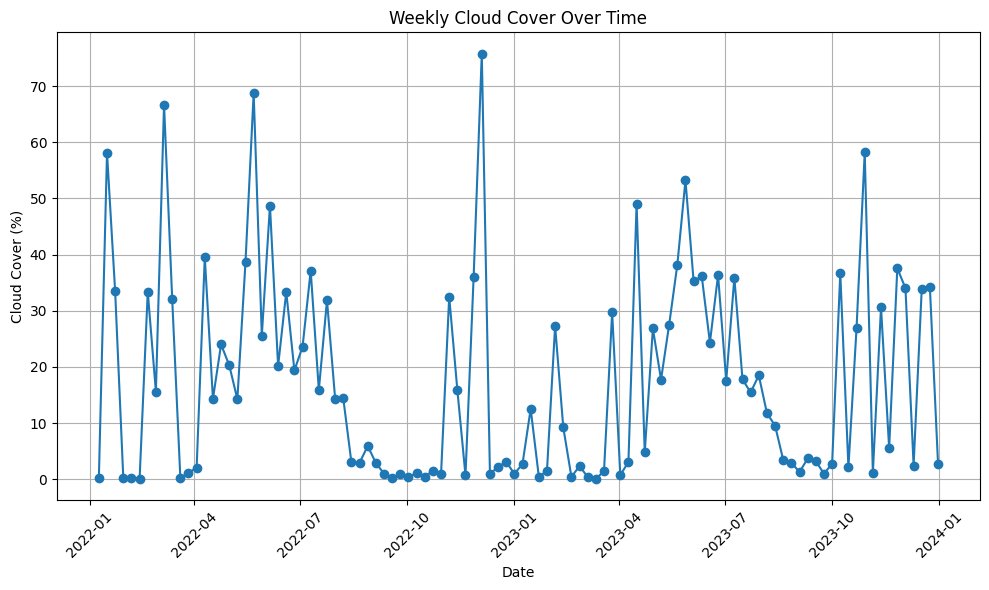

In [ ]:
# Group by date and calculate the mean cloud cover
df_mean = df.groupby(pd.Grouper(key='Date', freq='W')).mean()

# Plot the percentage of cloud cover over time
plt.figure(figsize=(10, 6))
plt.plot(df_mean.index, df_mean['Cloud Cover (%)'], marker='o', linestyle='-')
plt.title('Weekly Cloud Cover Over Time')
plt.xlabel('Date')
plt.ylabel('Cloud Cover (%)')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

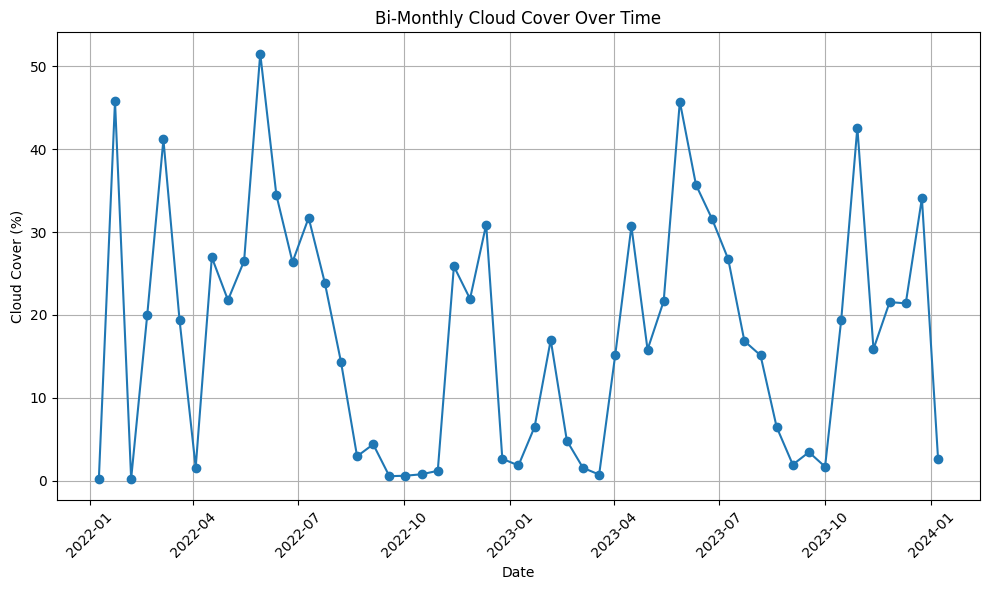

In [ ]:
# Group by date and calculate the mean cloud cover
df_mean = df.groupby(pd.Grouper(key='Date', freq='2W')).mean()

# Plot the percentage of cloud cover over time
plt.figure(figsize=(10, 6))
plt.plot(df_mean.index, df_mean['Cloud Cover (%)'], marker='o', linestyle='-')
plt.title('Bi-Monthly Cloud Cover Over Time')
plt.xlabel('Date')
plt.ylabel('Cloud Cover (%)')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

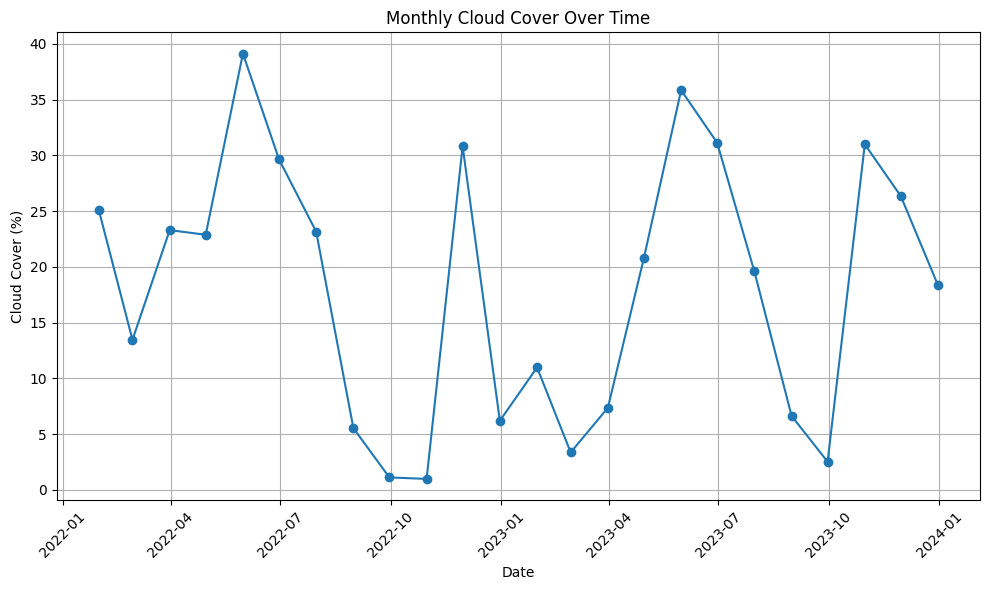

In [ ]:
# Group by date and calculate the mean cloud cover
df_mean = df.groupby(pd.Grouper(key='Date', freq='M')).mean()

# Plot the percentage of cloud cover over time
plt.figure(figsize=(10, 6))
plt.plot(df_mean.index, df_mean['Cloud Cover (%)'], marker='o', linestyle='-')
plt.title('Monthly Cloud Cover Over Time')
plt.xlabel('Date')
plt.ylabel('Cloud Cover (%)')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

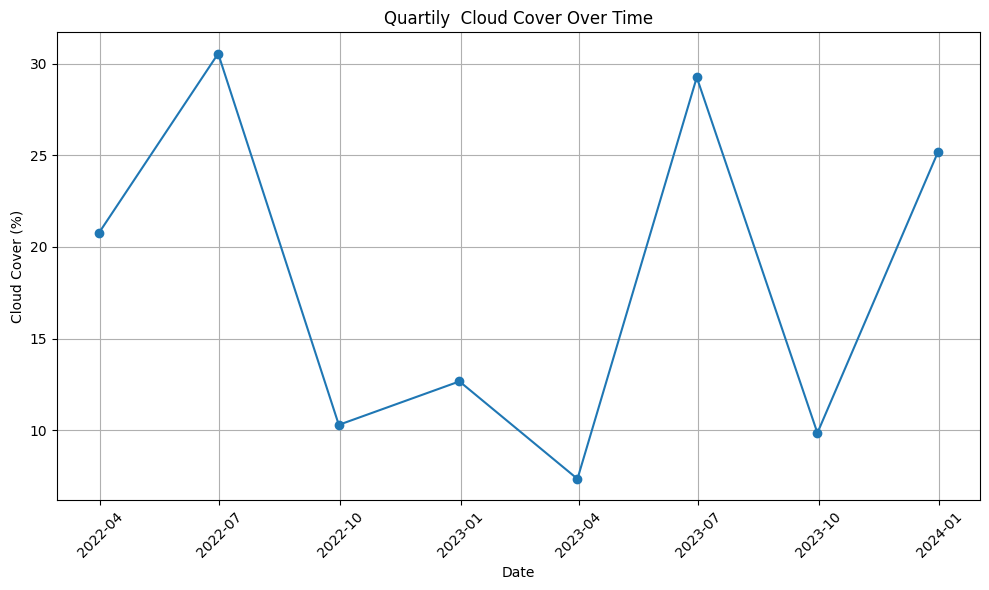

In [ ]:
# Group by date and calculate the mean cloud cover
df_mean = df.groupby(pd.Grouper(key='Date', freq='Q')).mean()

# Plot the percentage of cloud cover over time
plt.figure(figsize=(10, 6))
plt.plot(df_mean.index, df_mean['Cloud Cover (%)'], marker='o', linestyle='-')
plt.title('Quartily  Cloud Cover Over Time')
plt.xlabel('Date')
plt.ylabel('Cloud Cover (%)')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()